In [ ]:
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import  silhouette_score

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
#pio.renderers.default = "png"
from IPython.display import clear_output
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import MultiPoint

In [ ]:
df = pd.read_csv('https://storage.googleapis.com/jedha-projects/uber-data.csv')

In [ ]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [ ]:
# Basic stastistics

print(f"number of rows :", df.shape[0])
print()

print("Display of dataset : ")
display(df.head())
print()

print("Information of dataset : ")
display(df.info())
print()

print("Basic statistics : ")
data_desc = df.describe(include="all")
display(data_desc)
print()

print("Percentage of missing values : ")
display(100*df.isnull().sum()/df.shape[0])

number of rows : 4534327

Display of dataset : 


,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512



Information of dataset : 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4534327 entries, 0 to 4534326
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 138.4+ MB


None


Basic statistics : 


,Date/Time,Lat,Lon,Base
count,4534327,4.534327e+06,4.534327e+06,4534327
unique,260093,NaN,NaN,5
top,4/7/2014 20:21:00,NaN,NaN,B02617
freq,97,NaN,NaN,1458853
mean,NaN,4.073926e+01,-7.397302e+01,NaN
std,NaN,3.994991e-02,5.726670e-02,NaN
min,NaN,3.965690e+01,-7.492900e+01,NaN
25%,NaN,4.072110e+01,-7.399650e+01,NaN
50%,NaN,4.074220e+01,-7.398340e+01,NaN
75%,NaN,4.076100e+01,-7.396530e+01,NaN



Percentage of missing values : 


Date/Time    0.0
Lat          0.0
Lon          0.0
Base         0.0
dtype: float64

In [ ]:
#converting Date/Time into datetime
df['Date/Time'] = pd.to_datetime(df['Date/Time'], infer_datetime_format=True)

# Creating usable features from the Date column
df["Date"] = df["Date/Time"].dt.date
df["Time"] = df["Date/Time"].dt.time
df['Year'] = df['Date/Time'].dt.year
df['Month'] = df['Date/Time'].dt.month
df['Day'] = df['Date/Time'].dt.day
df['Day_of_week'] = df['Date/Time'].dt.day_name()
df['Hour'] = df['Date/Time'].dt.hour     # Monday = 0, Sunday = 6
df['Minute'] = df['Date/Time'].dt.minute
df['Second'] = df['Date/Time'].dt.second

# # Dropping Date column
# df = df.drop('Date', axis=1)

# Display DataFrame
df.head()

,Date/Time,Lat,Lon,Base,Date,Time,Year,Month,Day,Day_of_week,Hour,Minute,Second
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,2014-04-01,00:11:00,2014,4,1,Tuesday,0,11,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,2014-04-01,00:17:00,2014,4,1,Tuesday,0,17,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2014-04-01,00:21:00,2014,4,1,Tuesday,0,21,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2014-04-01,00:28:00,2014,4,1,Tuesday,0,28,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,2014-04-01,00:33:00,2014,4,1,Tuesday,0,33,0


In [ ]:
df['Base'].unique()

array(['B02512', 'B02598', 'B02617', 'B02682', 'B02764'], dtype=object)

In [ ]:
df1= df.sample(n=400000, weights='Hour', random_state=42)

In [ ]:
fig_1 = go.Figure()

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Monday']['Hour']))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Tuesday']['Hour'],
        visible = False))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Wednesday']['Hour'],
        visible = False))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Thursday']['Hour'],
        visible = False))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Friday']['Hour'],
        visible = False))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Saturday']['Hour'],
        visible = False))

fig_1.add_trace(
    go.Histogram(
        x = df1[df1['Day_of_week']=='Sunday']['Hour'],
        visible = False))


fig_1.update_layout(
        title = go.layout.Title(text = "Peak hours according to the day of the week (dropdown menu)", x = 0.5))

fig_1.update_layout(
    bargap=0.2,
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = [
                    go.layout.updatemenu.Button(
                        label = "Monday",
                        method = "update",
                        args = [{"visible" : [True, False, False, False, False, False, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Tuesday",
                            method = "update",
                            args = [{"visible" : [False, True, False, False, False, False, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Wednesday",
                            method = "update",
                            args = [{"visible" : [False, False, True, False, False, False, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Thursday",
                            method = "update",
                            args = [{"visible" : [False, False, False,True, False, False, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Friday",
                            method = "update",
                            args = [{"visible" : [False, False, False,False, True, False, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Saturday",
                            method = "update",
                            args = [{"visible" : [False, False, False,False, False, True, False]}]),
                    go.layout.updatemenu.Button(
                            label = "Sunday",
                            method = "update",
                            args = [{"visible" : [False, False, False,False, False, False, True]}]),

                ]
    )]
)
fig_1.show()

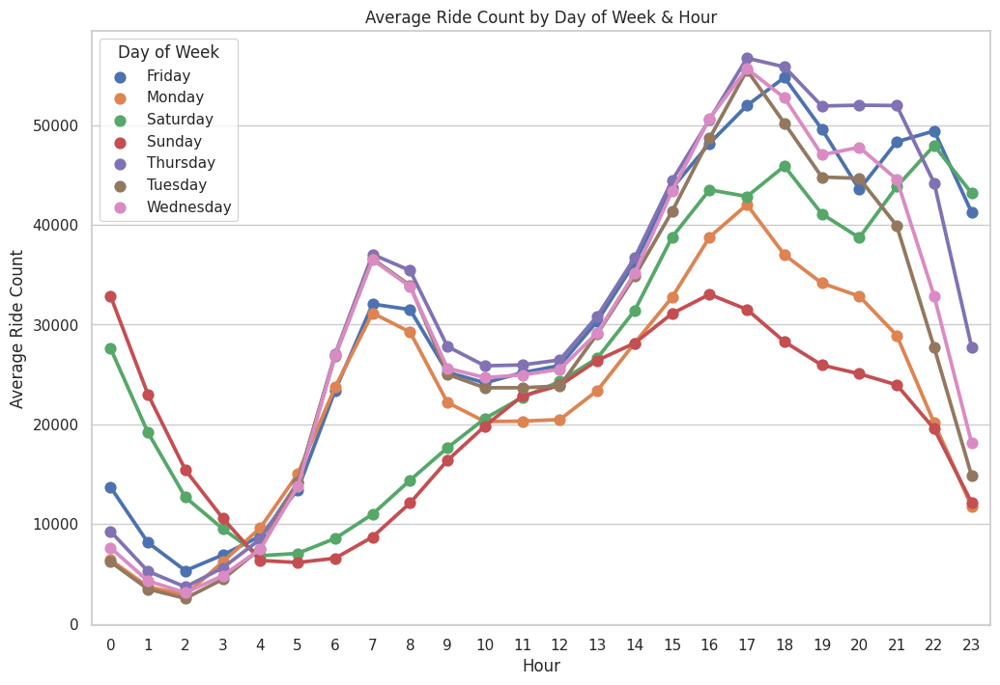

In [ ]:
# Calculate hourly average ride count by day of the week
hourly_avg = df.groupby(['Hour', 'Day_of_week'])['Date/Time'].count().reset_index()

# Calculate daily hourly average ride count and rename columns
daily_hourly_avg = hourly_avg.groupby(['Day_of_week', 'Hour'])['Date/Time'].mean().reset_index()
daily_hourly_avg.rename(columns={'Date/Time': 'average_ride_count'}, inplace=True)

# Set up the plot
plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")  # Set the style of the plot

# Check for empty groups before plotting
if not daily_hourly_avg.empty:
    # Create a pointplot using seaborn
    sns.pointplot(x='Hour', y='average_ride_count', hue='Day_of_week', data=daily_hourly_avg)

    # Set plot title and labels
    plt.title('Average Ride Count by Day of Week & Hour')
    plt.xlabel('Hour')
    plt.ylabel('Average Ride Count')

    # Show the plot
    plt.legend(title='Day of Week')

plt.show()

There is a first peak 5 to 9 AM from Monday to Friday and another (even more from Tuesday to Saturday) starting its rise at 13 and peaking around 16 to 21 AM

Saturdays & Sundays are the only days with still high average around midnight and low average on mornings, consistent with week-end activity.

In [ ]:
# Interactive map with plotly : uber pickups at different hours every day
fig = px.scatter_mapbox(df1,
                        lat="Lat",
                        lon="Lon",
                        color='Base',
                        category_orders={"Hour":[6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,0,1,2,3,4,5]},
                        size_max=8,
                        color_continuous_scale=px.colors.cyclical.IceFire,
                        animation_frame="Hour",
                        zoom=10,
                        mapbox_style="carto-positron")
fig.show()

In [ ]:
# Interactive map with plotly : uber pickups at different hours every day
fig = px.scatter_mapbox(df1,
                        lat="Lat",
                        lon="Lon",
                        color='Day_of_week',
                        category_orders={"Hour":[6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,0,1,2,3,4,5]},
                        size_max=8,
                        color_continuous_scale=px.colors.cyclical.IceFire,
                        animation_frame="Hour",
                        zoom=10,
                        mapbox_style="carto-positron")
fig.show()

### Try K-MEANS analysis on 2 features

In [ ]:
#Normalization of the geographical data
print('Dataset before normalization:\n')
display(df[['Lat', 'Lon']].head())
print()

# Create sample
df2= df.sample(n=100000, weights='Hour', random_state=42)

X = df2[['Lat', 'Lon']]
sc = StandardScaler()
X = sc.fit_transform(X)
print('Dataset after normalization:\n')
print(X[ :5, ])

Dataset before normalization:



,Lat,Lon
0,40.7690,-73.9549
1,40.7267,-74.0345
2,40.7316,-73.9873
3,40.7588,-73.9776
4,40.7594,-73.9722



Dataset after normalization:

[[ 0.03088141 -0.60382733]
 [-0.06976088 -0.23148516]
 [-0.0924054  -0.02346301]
 [-0.38426804 -0.53390392]
 [ 0.68505629  0.12862041]]


In [ ]:
# find the optimum number of clusters for our problem with elbow and silouhette
wcss =  []
sil = []
k = []

for i in range (2,15):
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
    sil.append(silhouette_score(X, kmeans.predict(X)))
    k.append(i)
    print("For K = {} : WCSS score = {} // Silouhette score = {}".format(i, wcss[-1], sil[-1]))

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 2 : WCSS score = 139713.70671344217 // Silouhette score = 0.7177760347432115


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 3 : WCSS score = 97676.47385477048 // Silouhette score = 0.4104021019569928


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 4 : WCSS score = 79092.77918124168 // Silouhette score = 0.4347597434127221


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 5 : WCSS score = 66263.95900588004 // Silouhette score = 0.45022751839118874


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 6 : WCSS score = 54449.96292054099 // Silouhette score = 0.4564869379675841


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 7 : WCSS score = 46010.507258755984 // Silouhette score = 0.47162666473839476


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 8 : WCSS score = 39736.55326344125 // Silouhette score = 0.47483752028019016


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 9 : WCSS score = 34894.88868882455 // Silouhette score = 0.4387421319108487


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 10 : WCSS score = 30638.236698737794 // Silouhette score = 0.44002025479707285


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 11 : WCSS score = 27295.500240288027 // Silouhette score = 0.39428948446732653


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 12 : WCSS score = 24397.69612520077 // Silouhette score = 0.45029761015473646


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 13 : WCSS score = 22204.52880545384 // Silouhette score = 0.4169836841393924


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



For K = 14 : WCSS score = 20549.43268900964 // Silouhette score = 0.42438061695635965


In [ ]:
#Save data in case we want to come back to it
k_means_dict = {'k_clusters':k, 'sil_score':sil, 'wcss':wcss}
k_means_data = pd.DataFrame(k_means_dict)
k_means_data.to_csv("kmeans_sil_wcss_X.csv")

In [ ]:
# Let's visualize inertia and silhouette scores
# Create DataFrame
wcss_frame = k_means_data.loc[ : , 'wcss']
cluster_scores = k_means_data.loc[ : , 'sil_score']
k_frame = k_means_data.loc[ : , 'k_clusters']

fig = make_subplots(rows=1,
                    cols=2,
                    subplot_titles=("Inertia per cluster", "Silhouette score per cluster",)
                   )


# Create inertia figure
fig.add_trace(go.Scatter(
    x=k_frame,
    y=wcss_frame),
    row = 1, col = 1,
)


# Create silouhette figure
fig.add_trace(go.Bar(
            x=k,
            y=cluster_scores),
            row = 1, col = 2
            )

fig.update_layout(title_text="KMeans clusters on Lat and Lon for apr14 between 10am and 2pm", showlegend = False)
fig.update_xaxes(title_text="Number of K clusters", row=1, col=1)
fig.update_yaxes(title_text="Calculated inertia", row=1, col=1)

fig.update_xaxes(title_text="Number of K clusters", row=1, col=2)
fig.update_yaxes(title_text="Silhouette score", row=1, col=2)

fig.show()

Going for 2 clusters doesn't make sense. We'll check 6 and 9.

In [ ]:
# On ré-entraîne un KMeans avec le nombre optimal de clusters
kmeans = KMeans(n_clusters=6,max_iter=300,random_state=42)
kmeans.fit(X)
np.unique(kmeans.labels_,return_counts=True)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



(array([0, 1, 2, 3, 4, 5], dtype=int32),
 array([42164,  5386,  3343,  8932, 39206,   969]))

In [ ]:
df2['km_clusters'] = kmeans.labels_
df2['km_clusters'] += 1
# Applying +1 to clusters (here and in other clusters below) to keep cluster "0" in the sampling.
#km_sample = raw.sample(n=10000, weights='km_clusters', random_state=1)

fig = px.scatter_mapbox(df2,lat='Lat',lon='Lon',color='km_clusters',
                        zoom=10,mapbox_style="carto-positron",width=1200,height=800,
                        title='KMeans clusters in NYC')
fig.show()

K-Means clustering basically gives us a center in Queens around Forest Hills from which all clusters start except n°5, which is made up of scattered points to the East : Newark. Clusters in NYC itself don't match anything particularly useful.
Clustering with 9 further divided some areas but did not isolate any useful information.

In [ ]:
# On ré-entraîne un KMeans avec le nombre optimal de clusters
kmeans2 = KMeans(n_clusters=9,max_iter=300,random_state=42)
kmeans2.fit(X)
np.unique(kmeans2.labels_,return_counts=True)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



(array([0, 1, 2, 3, 4, 5, 6, 7, 8], dtype=int32),
 array([36503,  8715,  2915, 34976,  3812,   965,   756,   232, 11126]))

In [ ]:
df2['km_clusters2'] = kmeans2.labels_
df2['km_clusters2'] += 1
# Applying +1 to clusters (here and in other clusters below) to keep cluster "0" in the sampling.
#km_sample = raw.sample(n=10000, weights='km_clusters', random_state=1)

fig = px.scatter_mapbox(df2,lat='Lat',lon='Lon',color='km_clusters2',
                        zoom=10,mapbox_style="carto-positron",width=1200,height=800,
                        title='KMeans clusters in NYC')
fig.show()

In [ ]:
dbscan = DBSCAN(eps=0.1,metric='manhattan',min_samples=150)
dbscan.fit(X)
np.unique(dbscan.labels_,return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9]),
 array([11448, 74898,  4254,  2045,  3351,   261,  2460,   231,   694,
          211,   147]))

In [ ]:
# Ignoring cluster -1 : outliers
df2['db_clusters'] = dbscan.labels_
df2['db_clusters'] += 1
db_sample = df2.sample(n=30000, weights='db_clusters', random_state=1)

fig = px.scatter_mapbox(db_sample,lat='Lat',lon='Lon',color='db_clusters',
                        zoom=10,mapbox_style="carto-positron",width=1200,height=800,
                        title='DBSCAN clusters in NYC')
fig.show()

In [ ]:
df3 = df2.sort_values(by='Hour')
fig = px.density_mapbox(df3, lat = 'Lat', lon = 'Lon', z = 'Hour', radius = 1,
                        mapbox_style='carto-positron',animation_frame = "Hour",
                        width=800, height=600,title = 'Hourly density of rides', zoom=9.5
                       )
# the 4 lines below only serve to fix the slider at a given hour, since the interactive map can't be shown on Github and the first frame (at 1 AM) wouldn't show much
def_hour = 19
fig.layout['sliders'][0]['active'] = def_hour
fig = go.Figure(data=fig['frames'][def_hour]['data'], frames=fig['frames'], layout=fig.layout)

fig.show()

In [ ]:
def uber_hotzones_nyc(max_distance,min_pickups,data,hour,day):
    #This is a modified version of code by Prof. Geoff Boeing, found here : https://geoffboeing.com/2014/08/clustering-to-reduce-spatial-data-set-size/

    # filter on hour
    sample_data = df[df['Hour']==hour]
    # filter on day
    #days = {'Monday':1,'Tuesday':2,'Wednesday':3,'Thursday':4,'Friday':5,'Saturday':6,'Sunday':7}
    sample_day = df['Day_of_week']
    sample_data = sample_data[sample_data['Day_of_week']==day]
    # get coordinates
    coords = sample_data[['Lat', 'Lon']].to_numpy()
    x_coords = sc.fit_transform(coords)

    # Clustering model
    db = DBSCAN(eps=max_distance, min_samples=min_pickups, metric='manhattan').fit(x_coords)

    # grouping clusters
    cluster_labels = db.labels_
    num_clusters = len(set(cluster_labels))
    clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])

    # initializing lists for hot spots
    lat = []
    lon = []
    num_members = []

    # loop through clusters and get centroids, number of members
    for i in range(len(clusters)):
        # filter empty clusters
        if clusters[i].any():
        # get centroid and magnitude of cluster
            lat.append(MultiPoint(clusters[i]).centroid.x)
            lon.append(MultiPoint(clusters[i]).centroid.y)
            num_members.append(len(clusters[i]))

    #output
    print(f'Number of recommended hot-zones: {num_clusters}')
    #plot on map
    fig = px.scatter_mapbox(lat=lat,lon=lon,
                            color=np.log(num_members),zoom=10,mapbox_style="carto-positron",
                            width=1000,height=800, title=f'DBSCAN clusters in NYC on {day} at {hour}',
                            labels={'color':'Hotness'})
    fig.show()


In [ ]:
max_distance = 0.1
min_pickups = 10 #lower value : the sample for a given day at a given hour is considerably smaller
hour = 22
day = 'Saturday'
uber_hotzones_nyc(max_distance, min_pickups, df, hour, day)

Number of recommended hot-zones: 31


And there we have it ! 19 recommendations for hot-zones on Saturdays at 22PM. No surprise the "hottest" is in Manhattan (near Madison Square in this case), but there are very good secondary hot-zones in Williamsburg & Prospect Heights (Brooklyn), as well as LGA, JFK & Newark Airports.

### **Conclusion**

Overall, DBSCAN required a little more tuning to implement (sampling, parameters) but produced much more interesting results and provided clearly identifiable hot spots

Uber is widely used in New York City.
In Manhattan, there is so much activity that drivers are active almost everywhere at most times. This might tell us that higher income areas result in more Uber requests, but it would have to be explored further to establish with more certainty.
We were however also able to identify more discriminately some areas of interest in more distant locations that are useful to provide recommendations to Uber drivers, especially when busy hours with likely heavy traffic could make Manhattan a sub-optimal choice.

To go further & improve our recommendations, we could gather more data : could weather an important factor ?